In [1]:
# Setup and parameters
import numpy as np
import matplotlib.pyplot as plt
from ratinabox.contribs.TaskEnvironment import (SpatialGoalEnvironment, TaskEnvironment, 
                                                SpatialGoal, Reward, Goal, get_goal_vector)
from ratinabox.Agent import Agent
from IPython import display
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

%matplotlib inline
speed = 12 # dials how fast agent runs
pausetime = 0.000001 # pause time in plot
plt.close('all')


# Setting up reward 💰 functions

Configure the reward given for reaching a goal. Some options include setting decay function, decay parameters or an external driving function, e.g. a gradient. Rewards once they're given to an agent remain active until they expire (this is optional).


Text(0.5, 0.98, 'Linear decay reward functions')

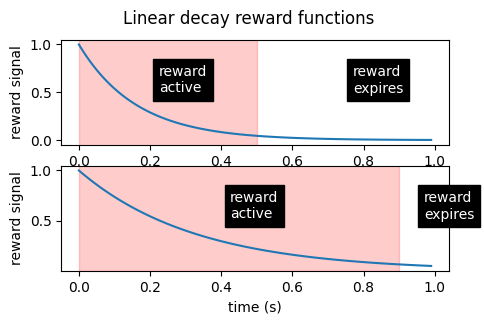

In [2]:
fig, axs = plt.subplots(2,1, figsize=(5,3))
plt.sca(axs[0])
r_exp=Reward(1, expire_clock=0.5, decay="linear", decay_knobs=[6])
r_exp.plot_theoretical_reward()
plt.sca(axs[1])
r_exp2=Reward(1, expire_clock=0.9, decay="linear", decay_knobs=[3])
r_exp2.plot_theoretical_reward()
plt.suptitle('Linear decay reward functions')

Text(0.5, 0.98, 'Constant decay reward function')

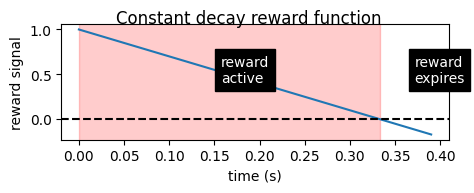

In [3]:
fig, axs = plt.subplots(1,1, figsize=(5,1.5))
plt.sca(axs)
r_con=Reward(1, expire_clock=1/3, decay="constant", decay_knobs=[3])
r_con.plot_theoretical_reward((0,0.4))
plt.axhline([0], c="black", linestyle="dashed")
plt.suptitle('Constant decay reward function')

# 🎯 `Goal` objects are used to 🔍 _detect a condition_ and 💰 _release reward_

We can create `Goal` objects which we later will associate with our `TaskEnvironment` subclass. `Goal` objects special objects that merely check for a rule or objective being satisfied. Maybe your agent enters a special region in space with a reward, a `SpatialGoal`. This will check for the agent accomplishing this feat and optionally release a reward when it happens.

In [16]:
# Place instruction here

# ⚙️ Configuring `TaskEnvironment` with 🐀 `Agent` objects

Let's take the example task environment, `SpatialGoalTaskEnvironment`; it's configured it to work with `SpatialGoal` objects, although you could pass `SpatialGoal` objects to a vanilla `TaskEnvironment`. 

There are two approaches to setting up goals for a task. 
- One you make a pool of goal objects yourself and give them to the environment. This is the least opaque.
- The other, you allow `SpatialGoalTaskEnvironment` to construct your goals using keyword arguments the `goalkws` passed to `SpatialTaskEnvironment`. This let's it manage creating them for you. New TaskEnvironments have to have the internal machinery (which is fairly lightweight) to automate this.

The `GoalCache` tracks a set of goals across agents. It is constructed (__init__) with `goalcachekws`. In particular,

- `agentmode`, which can be "interact" or "noninteract". "interact" means agent accomplishing a goal accomplishes the goal for all agents, consuming the goal.
- `goalorder`, can be "sequential" or "nonsequential". do the goals need to be accomplished in sequence or does sequence not matter? you could also pass in a custom funtion to determine special rules about how to transition between goals.

To give it goals, you can do one of two things ... either
- pass in a set of goals. this set consitutes a `goal_reservoir` that is drawn from each time you call episode `.reset()`.
- or for convenience, `SpatialGoalEnviroment` was tweaked with special machinery to simply say what kws you would like to form a `goal_reservoir` and how many goals you would like.

🍎 Easy example: Manually crafting goals and integrating them into a versatile TaskEnvironment

First, we're going to dive into the most adaptable scenario. We'll be forging our own 🎯 Goal objects, each with a 💰 Reward attached, and then delivering them to a TaskEnvironment or SpatialTaskEnvironment. To start, let's bring our generic TaskEnvironment object to life.

In [4]:
env = SpatialGoalEnvironment(params={'dimensionality':'2D'},
                             render_every=1, # how often to draw on .render() 
                             teleport_on_reset=False, # teleport animal to new location each episode?
                             verbose=False)

Now, let's bring some goals to life for our environment. When initializing the goals, I acquaint them with the environment they'll inhabit. This process generates two spatial goals at random coordinates within the environment 🎲, along with one goal that has a precise position and a reward object `r_con` that's granted upon completion 🎯. The remaining goals will be equipped with the default reward object.


In [14]:
goals = [SpatialGoal(env), SpatialGoal(env),
         SpatialGoal(env, pos=[0.2, 0.2], reward=r_con)]

We're now ready to introduce these goals to the environment and recruit some agents 🤖. With that, our task is all set and ready for action 🚀.

The render function will illustrate your environment, agents, and anything else that the task environment is programmed to depict. In the case of `SpatialGoalEnvironment`, it's been fine-tuned to showcase spatial goal objects 🎯.

    • To AUTOMATICALLY save all plots (recommended), set  `ratinabox.autosave_plots = True`
    • To MANUALLY save plots, call                        `ratinabox.utils.save_figure(figure_object, save_title).
      This warning will not be shown again
HINT: You can stylize plots to make them look like repo/paper by calling `ratinabox.stylize_plots()`
      This hint will not be shown again


(<Figure size 640x480 with 1 Axes>, <AxesSubplot:>)

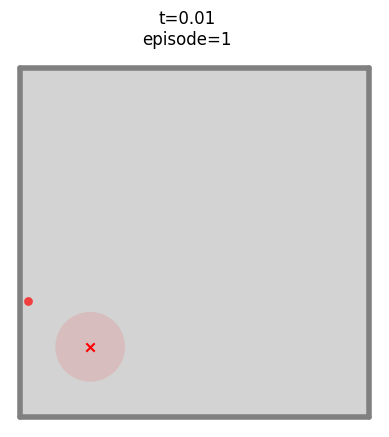

In [6]:
Ag = Agent(env)
env.goal_reservoir = goals
env.add_agents(Ag)
env.step1() # Take a single action randomly
env.render()

In [9]:
def animate_update(*pos, **kws):
    dir_to_reward = {name:get_goal_vector(Ag)
                     for name, Ag in env.Agents.items()}
    drift_velocity = {agent : speed * Ag.speed_mean * 
            (dir_to_reward / np.linalg.norm(dir_to_reward))
            for (agent, dir_to_reward) in dir_to_reward.items()}
    observation, reward, terminate_episode, _, info = \
            env.step(drift_velocity)
    fig, ax = env.render()
    if any(terminate_episode.values()):
        print("done! reward:", reward)
        env.reset()
        print("starting episode:", env.episode)
    return fig

The function above carries out a single update, where our agent 🤖 is endowed with an action (a drift velocity indicating the direction towards the reward 💰). Following this, both the environment and the agents respond to this action. Subsequently, the `.render()` function is invoked, returning a visual representation of the current state of the environment.

(If we were not using `FuncAnimation` and jupyter here, you could just blurt this into a while loop, and would see a quick live-rendered plot.)

done! reward: {'agent_0': 1}
starting episode: 2
done! reward: {'agent_0': 1}
starting episode: 3
done! reward: {'agent_0': 1.99}
starting episode: 4
done! reward: {'agent_0': 1}
starting episode: 5
done! reward: {'agent_0': 1}
starting episode: 6
done! reward: {'agent_0': 1.785678140807219}
starting episode: 7
done! reward: {'agent_0': 2.7678213593991465}
starting episode: 8
done! reward: {'agent_0': 3.7401431458051553}
starting episode: 9
done! reward: {'agent_0': 4.702741714347104}
starting episode: 10
done! reward: {'agent_0': 1}
starting episode: 11
done! reward: {'agent_0': 1}
starting episode: 12
done! reward: {'agent_0': 1.6426116020847183}
starting episode: 13
done! reward: {'agent_0': 2.6261854860638714}
starting episode: 14
done! reward: {'agent_0': 1}
starting episode: 15
done! reward: {'agent_0': 1.99}
starting episode: 16
done! reward: {'agent_0': 2.9701}
starting episode: 17


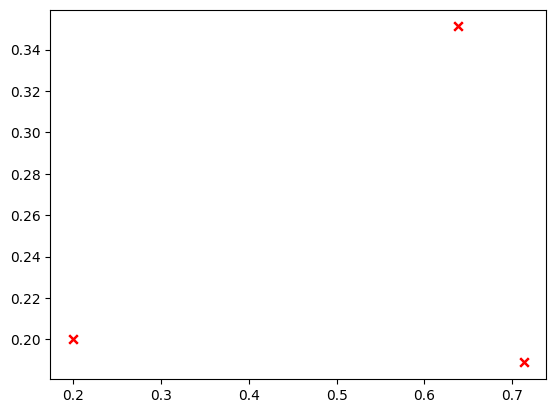

In [10]:
fig, ax = env.render(); # get the figure and axis
anim = FuncAnimation(fig, animate_update, range(1000), blit=False) # animate 1000 of of the environment-action loop
HTML(anim.to_jshtml(fps=180))

## 🚀 Shortcut to crafting SpatialGoals through a SpatialGoalEnvironment

The derived class, SpatialGoalEnvironment, comes with its own set of convenience functions. These allow you to simply specify the number of goals and provide the construction arguments goalkws. You can also fine-tune features of the goalcache, as we discussed earlier, such as designating whether the goals are sequential or not, or if they're shared among agents 🤖.

In [12]:
pick_n_goals = 2
goalkws      = dict(reward=r_exp) # Goal.__init__ kws called within Task, we could also just provide `Goal` objects
goalcachekws = dict(agentmode="noninteract",
                    goalorder="nonsequential") # GoalCache.__init__ kws

env = SpatialGoalEnvironment(
    pick_n_goals=pick_n_goals,
    teleport_on_reset=False,   # 
    goalkws=goalkws,           # Reward will be attached to the `Goal` object
    goalcachekws=goalcachekws, # Goals will be tracked by the cache
)

# Add our agents to the environment}
Ag = Agent(env)
Ag2 = Agent(env)
env.add_agents(Ag)
env.add_agents(Ag2)
print("Agent names: ",env.agent_names)

And now let's run the environment :)

done! reward: {'agent_0': 1.6111172395328652, 'agent_1': 1.5811679762753923}
starting episode: 2
done! reward: {'agent_0': 1.8684626535836242, 'agent_1': 1.7524805469537772}
starting episode: 3
done! reward: {'agent_0': 1, 'agent_1': 0}
starting episode: 4
done! reward: {'agent_0': 1.9509900499000001, 'agent_1': 0}
starting episode: 5
done! reward: {'agent_0': 1, 'agent_1': 0.8863848717161293}
starting episode: 6
done! reward: {'agent_0': 1, 'agent_1': 0}
starting episode: 7


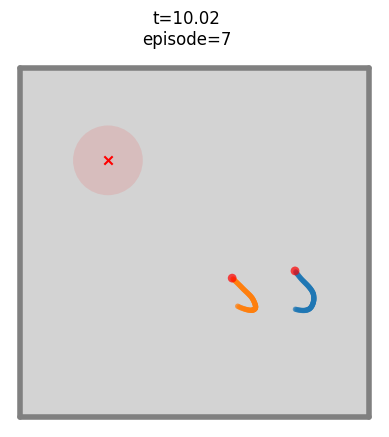

In [13]:
fig, ax = env.render(); # does not return a figure until something happens
anim = FuncAnimation(fig, animate_update, range(1000), blit=False)
HTML(anim.to_jshtml(fps=180))

# CUSTOMIZING NEW ENVIRONMENTS 🛠️ 🎨

Let's say we want to make our own special environment. Here's an example of how easy that is. It breaks down as follows
- Make a `Goal` object(s) or adapt existing `Goal` object(s)
- Create a pool of those goals, attaching rewards/punishments.
- possibly define .reset() if you need to specially order goals when episodes reset

and voila! Your task is ready to go 🚀

## Goal example 1, stand-still for 10 seconds == reward
Let's say we want to create a custom goal that checks if any animal is still for 10 seconds. I can implement it simply as:

In [ ]:
class StillnessGoal(Goal):
    
    def __init__(self, how_long, velocity_thresh):
        super().__init__()
        self.how_long = how_long
        self.velocity_thresh = velocity_thresh
        self.lastmove = {agent:0 for agent in self.Agents}
    
    def check(self, agents):
        successful_agents = []
        for name, agent in Agents.items():
            if agent.velocity > self.velocity_thresh:
                self.last_move[name] = agent.t
            if agent.t - self.last_move[name] > self.how_long:
                successful_agents.append(name)
        return {name:reward for name in successful_agents}

## Goal example 2, building on that!
Let's say now we'd like to reward an animal not JUST for standing still, but rather, we'd like to reward it for standing still AT a special location `SpatialGoal`. Polymorphism let's us rip out that combination goal quickly.

In [ ]:
class StillnessSpatialGoal(StillnessGoal, SpatialGoal):
    def __init__(self, **kws):
        SpatialGoal.__init__(self, **kws)
        StillnessGoal.__ini__(self, **kws)
    def check(self, agents):
        answer1 = SpatialGoal.check(agents=agents)
        answer2 = SpatialGoal.check(agents=agents)
        return answer1.items() & answer2.items()

## Plugging our examples into a Task

Now that we have two new goals, let's slot them into a task, then have an agent learn that task.